<a href="https://colab.research.google.com/github/lionman9097/Rafi1337/blob/main/WGAN_GP_10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#1.IMPORT LIBRARY

In [ ]:
# import libraries
import torch, torchvision, os, PIL, pdb
import matplotlib.pyplot as plt
import numpy as np
import pickle

from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
from PIL import Image
from google.colab import files
from torchsummary import summary
from model import Generator, Critic

def show(tensor, num=25, wandbactive=0, name=''):
  data = tensor.detach().cpu()
  grid = make_grid(data[:num], nrow=5).permute(1,2,0)

  ## optional
  if (wandbactive==1):
    wandb.log({name:wandb.Image(grid.numpy().clip(0,1))})

  plt.imshow(grid.clip(0,1))
  plt.show()

### hyperparameters and general parameters
n_epochs=10
batch_size=128
lr=1e-4
z_dim=200
device='cuda' #GPU

cur_step=0
crit_cycles=5
gen_losses=[]
crit_losses=[]
show_step=35
save_step=35

wandbact=1


In [ ]:
#### optional
!pip install wandb -qqq
import wandb
wandb.login(key='5cab7766a9bdcf360a2a08c71cadedb7a92343db')

wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
%%capture
experiment_name = wandb.util.generate_id()

myrun=wandb.init(
    project="wgan",
    group=experiment_name,
    config={
        "optimizer":"adam",
        "model":"wgan gp",
        "epoch":"10",
        "batch_size":128
    }
)

config=wandb.config

#2. CREATE WGAN-GP MODEL GENERATOR & CRITIC
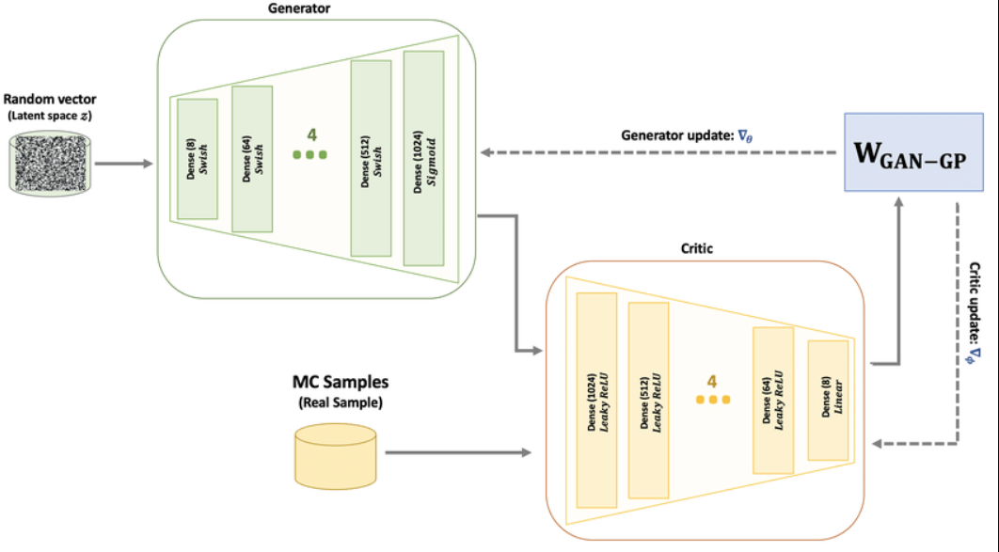

In [ ]:
# Generator Model

class Generator(nn.Module):
  def __init__(self, z_dim=200, d_dim=16):
    super(Generator, self).__init__()
    self.z_dim=z_dim

    self.gen = nn.Sequential(
            nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0), ## 4x4 (ch: 200, 512)
            nn.BatchNorm2d(d_dim*32),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*32, d_dim*16, 4, 2, 1), ## 8x8 (ch: 512, 256)
            nn.BatchNorm2d(d_dim*16),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*16, d_dim*8, 4, 2, 1), ## 16x16 (ch: 256, 128)
            #(n-1)*stride -2*padding +ks = (8-1)*2-2*1+4=16
            nn.BatchNorm2d(d_dim*8),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*8, d_dim*4, 4, 2, 1), ## 32x32 (ch: 128, 64)
            nn.BatchNorm2d(d_dim*4),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*4, d_dim*2, 4, 2, 1), ## 64x64 (ch: 64, 32)
            nn.BatchNorm2d(d_dim*2),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*2, 3, 4, 2, 1), ## 128x128 (ch: 32, 3)
            nn.Tanh() ### produce result in the range from -1 to 1
    )


  def forward(self, noise):
    x=noise.view(len(noise), self.z_dim, 1, 1)  # 128 x 200 x 1 x 1
    return self.gen(x)


def gen_noise(num, z_dim, device='cuda'):
   return torch.randn(num, z_dim, device=device) # 128 x 200

gen = Generator(z_dim).to('cuda')
summary(gen, (z_dim, 1, 1), device='cuda')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]       1,638,912
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,408
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,416
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,136
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13           [-1, 32, 64, 64]          32,800
      BatchNorm2d-14           [-1, 32,

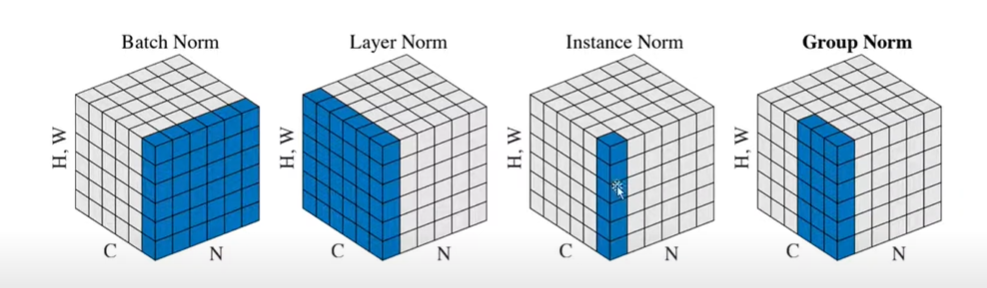

In [ ]:
## critic model

class Critic(nn.Module):
  def __init__(self, d_dim=16):
    super(Critic, self).__init__()

    self.crit = nn.Sequential(
      nn.Conv2d(3, d_dim, 4, 2, 1), #(n+2*pad-ks)//stride +1 = (128+2*1-4)//2+1=64x64 (ch: 3,16)
      nn.InstanceNorm2d(d_dim),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim, d_dim*2, 4, 2, 1), ## 32x32 (ch: 16, 32)
      nn.InstanceNorm2d(d_dim*2),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), ## 16x16 (ch: 32, 64)
      nn.InstanceNorm2d(d_dim*4),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1), ## 8x8 (ch: 64, 128)
      nn.InstanceNorm2d(d_dim*8),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1), ## 4x4 (ch: 128, 256)
      nn.InstanceNorm2d(d_dim*16),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*16, 1, 4, 1, 0), #(n+2*pad-ks)//stride +1=(4+2*0-4)//1+1= 1X1 (ch: 256,1)
    )


  def forward(self, image):
    # image: 128 x 3 x 128 x 128
    crit_pred = self.crit(image) # 128 x 1 x 1 x 1
    return crit_pred.view(len(crit_pred),-1) ## 128 x 1

crit = Critic().to('cuda')
summary(crit, (3, 128, 128), device='cuda')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 16, 64, 64]             784
    InstanceNorm2d-2           [-1, 16, 64, 64]               0
         LeakyReLU-3           [-1, 16, 64, 64]               0
            Conv2d-4           [-1, 32, 32, 32]           8,224
    InstanceNorm2d-5           [-1, 32, 32, 32]               0
         LeakyReLU-6           [-1, 32, 32, 32]               0
            Conv2d-7           [-1, 64, 16, 16]          32,832
    InstanceNorm2d-8           [-1, 64, 16, 16]               0
         LeakyReLU-9           [-1, 64, 16, 16]               0
           Conv2d-10            [-1, 128, 8, 8]         131,200
   InstanceNorm2d-11            [-1, 128, 8, 8]               0
        LeakyReLU-12            [-1, 128, 8, 8]               0
           Conv2d-13            [-1, 256, 4, 4]         524,544
   InstanceNorm2d-14            [-1, 25

In [ ]:
def init_weights(m):
    if isinstance(m, nn.Conv2d) or isinstance(m,nn.ConvTranspose2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      torch.nn.init.constant_(m.bias,0)

    if isinstance(m,nn.BatchNorm2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      torch.nn.init.constant_(m.bias,0)

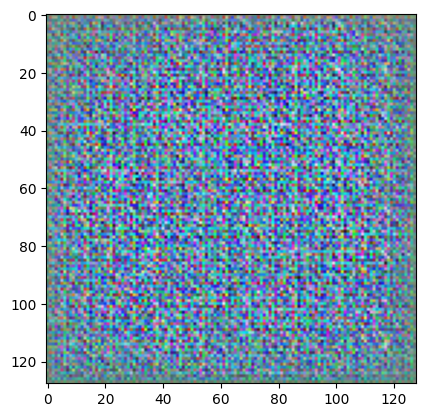

In [ ]:
noise = gen_noise(1, z_dim)  # Hasilkan noise untuk 1 gambar
with torch.no_grad():
    generated_image = gen(noise)

# Denormalisasi
generated_image = 0.5 * generated_image + 0.5

# Konversi ke gambar PIL
generated_image = transforms.ToPILImage()(generated_image[0].cpu())

# Tampilkan gambar
plt.imshow(generated_image)
plt.show()

#3. LOAD DATASET

In [ ]:
files.upload()


Saving kaggle.json to kaggle (1).json


{'kaggle (1).json': b'{"username":"raihan334512","key":"59bc44a5db5bbf85e0e98edf0912d6e6"}'}

In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
! kaggle datasets download -d jessicali9530/celeba-dataset
! unzip /content/celeba-dataset.zip
! rm celeba-dataset.zip

Streaming output truncated to the last 5000 lines.
  inflating: img_align_celeba/img_align_celeba/197605.jpg  
  inflating: img_align_celeba/img_align_celeba/197606.jpg  
  inflating: img_align_celeba/img_align_celeba/197607.jpg  
  inflating: img_align_celeba/img_align_celeba/197608.jpg  
  inflating: img_align_celeba/img_align_celeba/197609.jpg  
  inflating: img_align_celeba/img_align_celeba/197610.jpg  
  inflating: img_align_celeba/img_align_celeba/197611.jpg  
  inflating: img_align_celeba/img_align_celeba/197612.jpg  
  inflating: img_align_celeba/img_align_celeba/197613.jpg  
  inflating: img_align_celeba/img_align_celeba/197614.jpg  
  inflating: img_align_celeba/img_align_celeba/197615.jpg  
  inflating: img_align_celeba/img_align_celeba/197616.jpg  
  inflating: img_align_celeba/img_align_celeba/197617.jpg  
  inflating: img_align_celeba/img_align_celeba/197618.jpg  
  inflating: img_align_celeba/img_align_celeba/197619.jpg  
  inflating: img_align_celeba/img_align_celeba/19

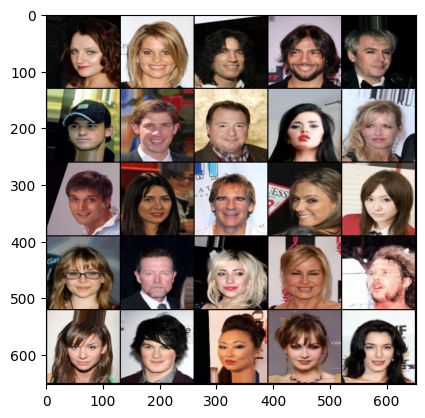

In [ ]:
### Dataset, DataLoader, declare gen,crit, test dataset

class Dataset(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes=[size, size]
    items, labels=[],[]

    for data in os.listdir(path)[:lim]:
      item = os.path.join(path,data)
      items.append(item)
      labels.append(data)
    self.items=items
    self.labels=labels


  def __len__(self):
    return len(self.items)

  def __getitem__(self,idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB') # (178,218)
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128 x 128 x 3
    data = np.transpose(data, (2,0,1)).astype(np.float32, copy=False) # 3 x 128 x 128 # from 0 to 255
    data = torch.from_numpy(data).div(255) # from 0 to 1
    return data, self.labels[idx]

## Dataset
data_path='/content/img_align_celeba/img_align_celeba'
ds = Dataset(data_path, size=128, lim=10000)

## DataLoader
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)

## Models
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

## Optimizers
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5,0.9))
crit_opt= torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5,0.9))

#wandb optional
if (wandbact==1):
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x,y=next(iter(dataloader))
show(x)

#4. GRADIENT PENALTY

### Rumus Loss dan Gradient Penalty
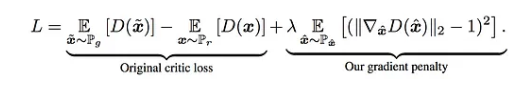

###Cara Gradient Penalty Bekerja

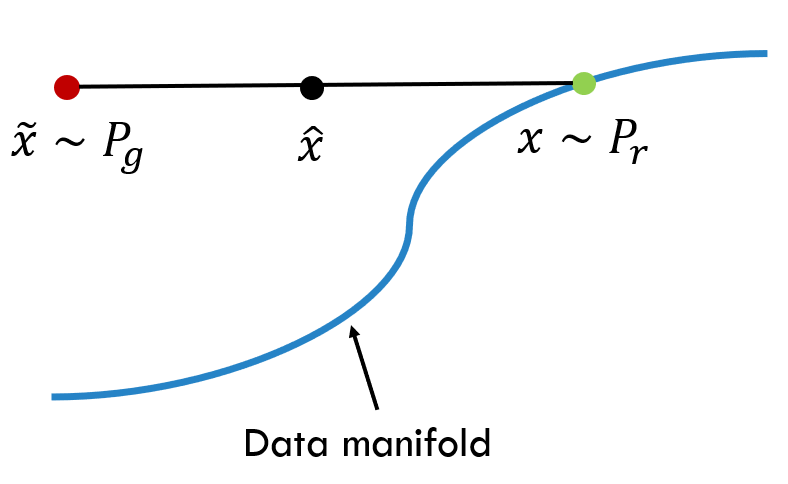

In [ ]:
## gradient penalty calculation

def get_gp(real, fake, dis, alpha, gamma=10):
  mix_images = real * alpha + fake * (1-alpha) # 128 x 3 x 128 x 128
  mix_scores = dis(mix_images) # 128 x 1

  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs=torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True,
  )[0] # 128 x 3 x 128 x 128

  gradient = gradient.view(len(gradient), -1)   # 128 x 49152
  gradient_norm = gradient.norm(2, dim=1)
  gp = gamma * ((gradient_norm-1)**2).mean()

  return gp

#5. SAVE AND LOAD CHECKPOINTS

In [ ]:
## Save and load checkpoints

root_path='./img_align_celeba/'

def save_checkpoint(name):
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict()
  }, f"{root_path}G-{name}.pkl")

  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict()
  }, f"{root_path}C-{name}.pkl")

  print("Saved checkpoint")

def load_checkpoint(name):
  checkpoint = torch.load(f"{root_path}G-{name}.pkl")
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  checkpoint = torch.load(f"{root_path}C-{name}.pkl")
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  print("Loaded checkpoint")

#6. TRAINING

  0%|          | 0/79 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Saving checkpoint:  35 35
Saved checkpoint


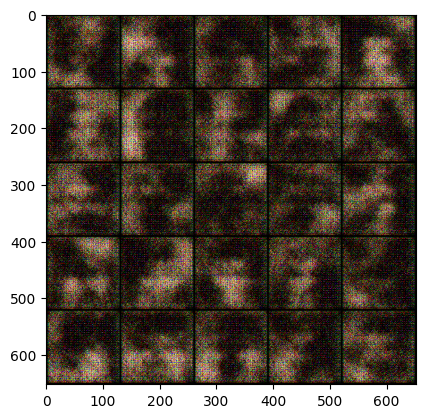

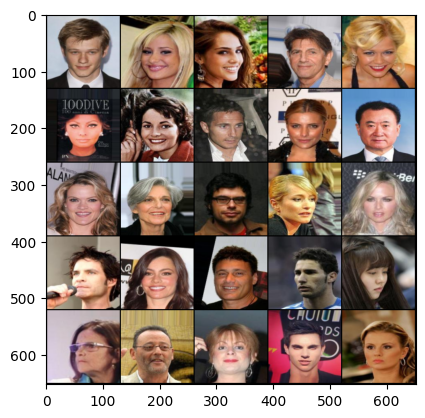

Epoch: 0: Step 35: Generator loss: 9.849515946848053, critic loss: -9.769853937966483


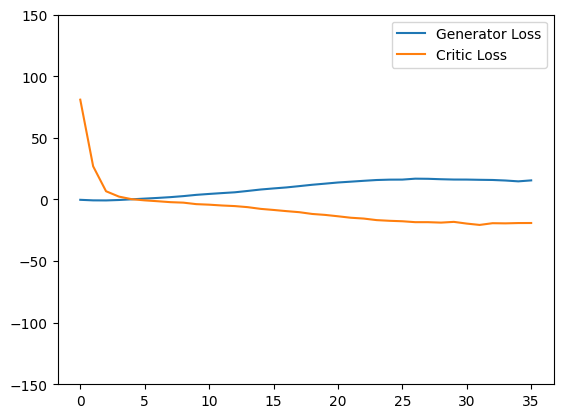

Saving checkpoint:  70 35
Saved checkpoint


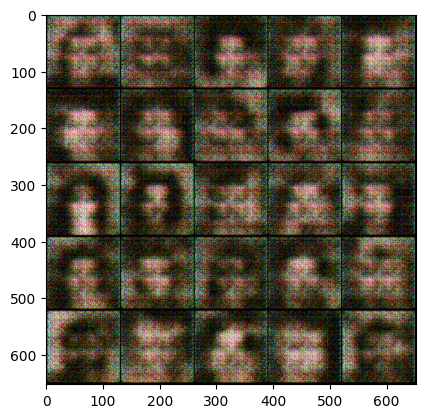

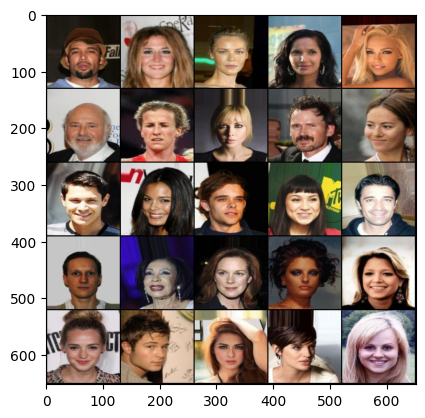

Epoch: 0: Step 70: Generator loss: 20.9982850755964, critic loss: -25.041433083670483


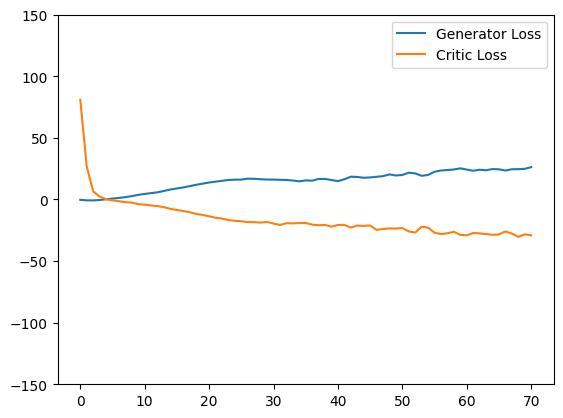

/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  105 35
Saved checkpoint


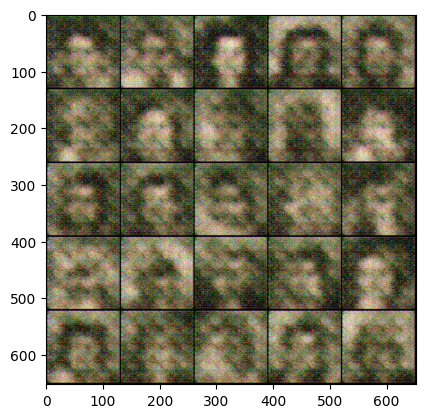

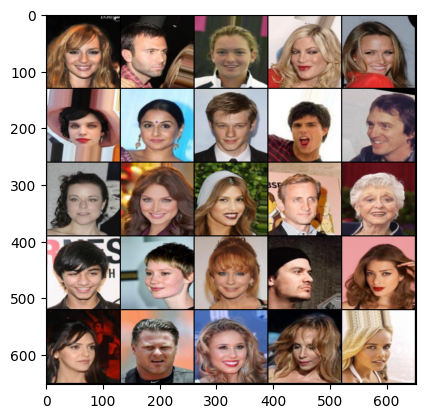

Epoch: 1: Step 105: Generator loss: 23.48572572980608, critic loss: -24.45502435956682


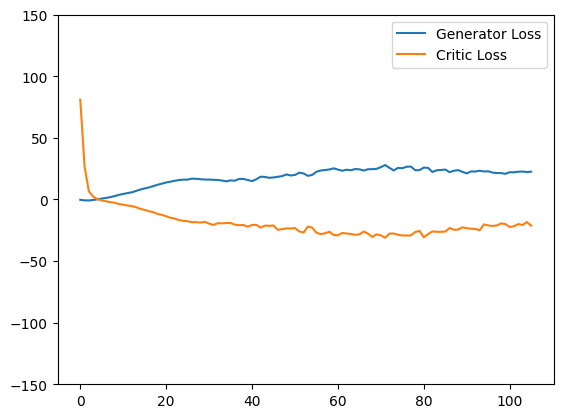

Saving checkpoint:  140 35
Saved checkpoint


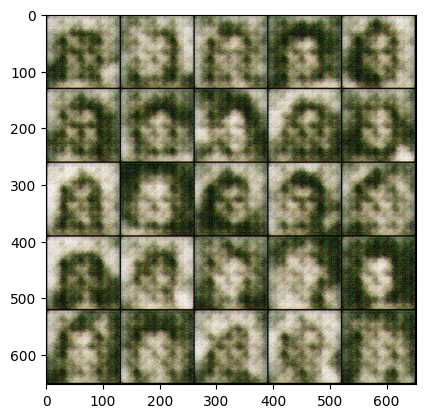

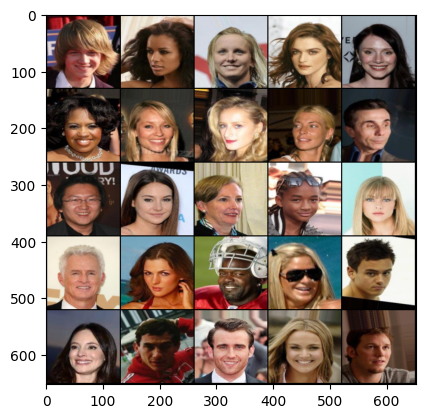

Epoch: 1: Step 140: Generator loss: 24.257039969308035, critic loss: -18.096498009817935


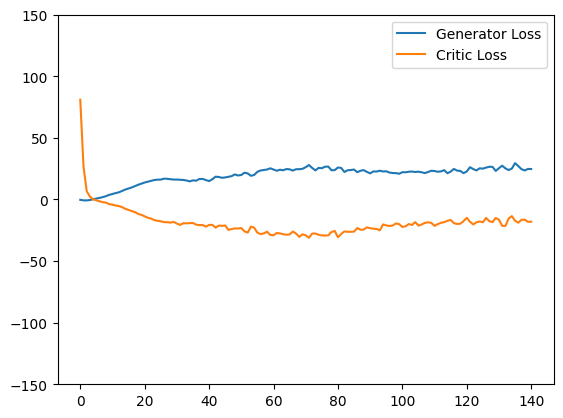

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  175 35
Saved checkpoint


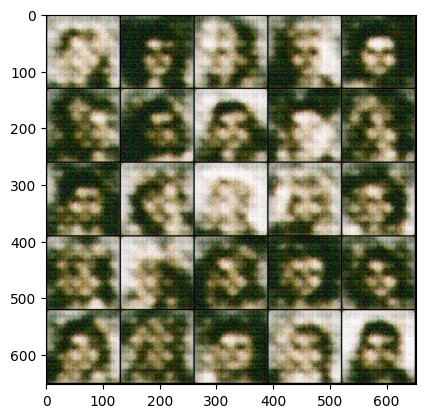

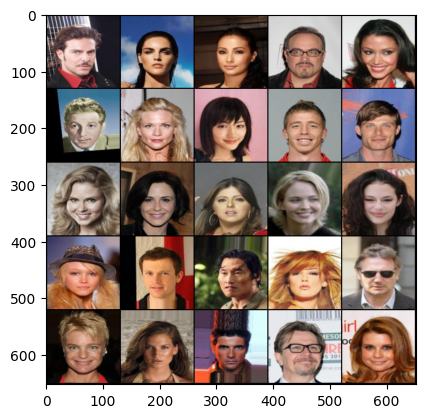

Epoch: 2: Step 175: Generator loss: 26.8942384992327, critic loss: -17.049842621939522


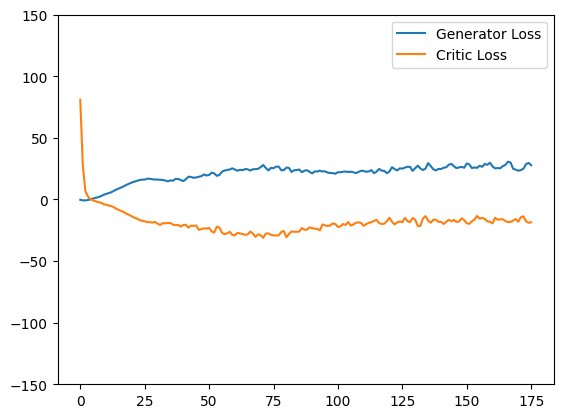

Saving checkpoint:  210 35
Saved checkpoint


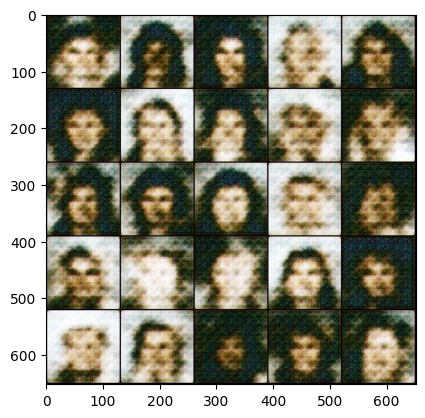

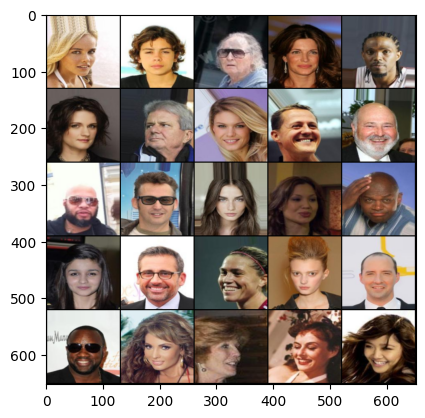

Epoch: 2: Step 210: Generator loss: 26.07583901541574, critic loss: -16.2838128389631


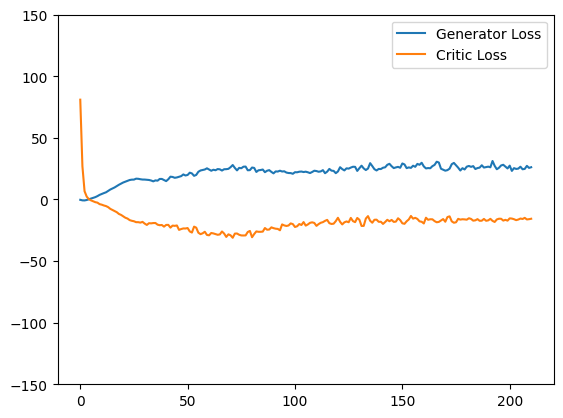

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  245 35
Saved checkpoint


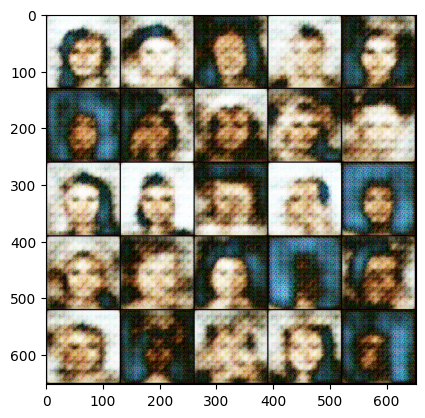

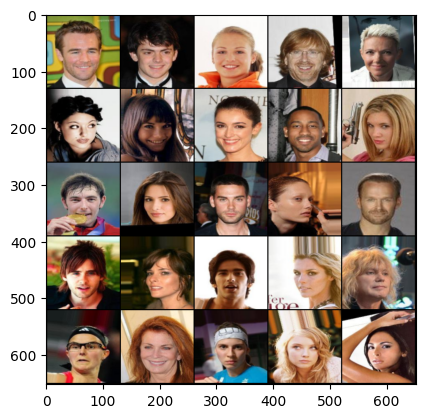

Epoch: 3: Step 245: Generator loss: 24.347603334699357, critic loss: -15.58257405962263


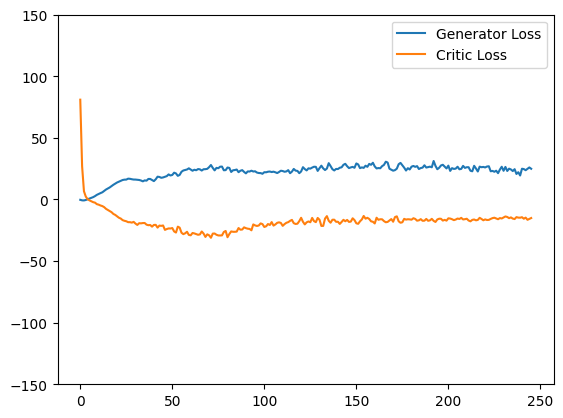

Saving checkpoint:  280 35
Saved checkpoint


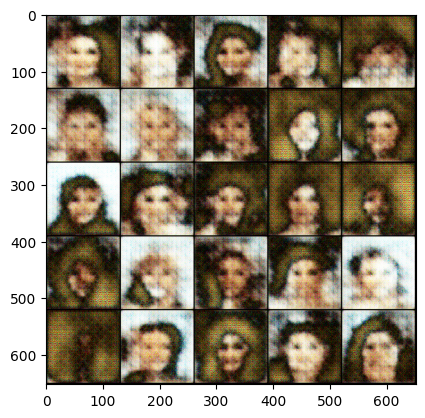

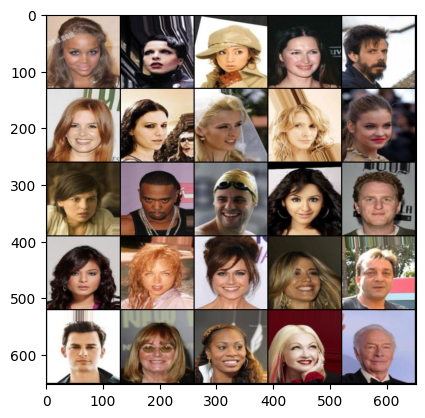

Epoch: 3: Step 280: Generator loss: 26.205644171578545, critic loss: -14.441769114903042


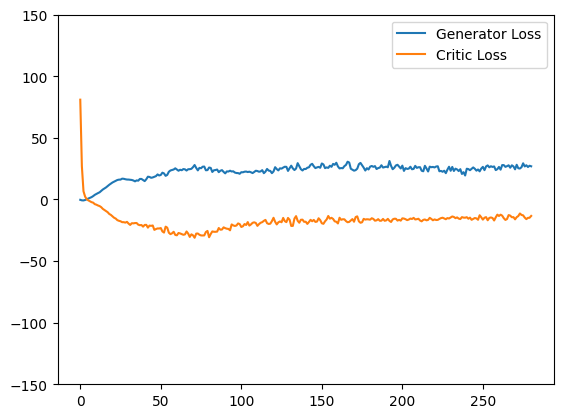

Saving checkpoint:  315 35
Saved checkpoint


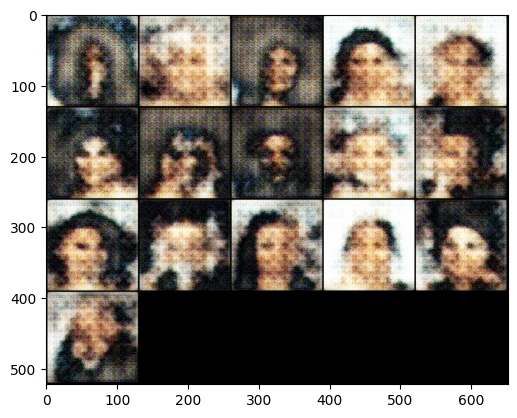

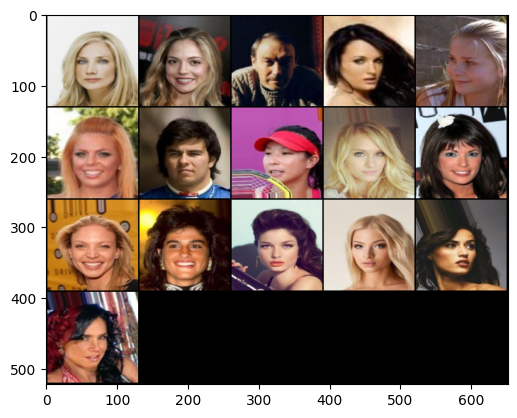

Epoch: 3: Step 315: Generator loss: 26.62311581202916, critic loss: -13.846142480032784


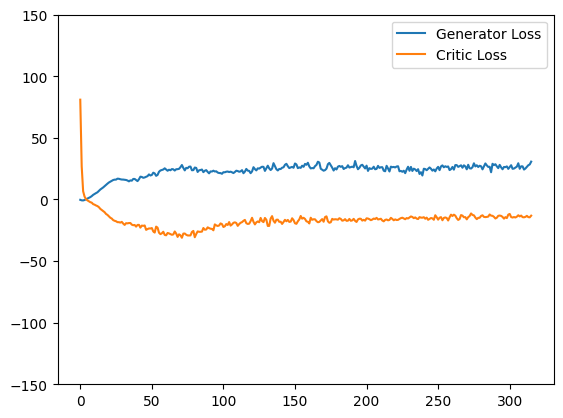

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  350 35
Saved checkpoint


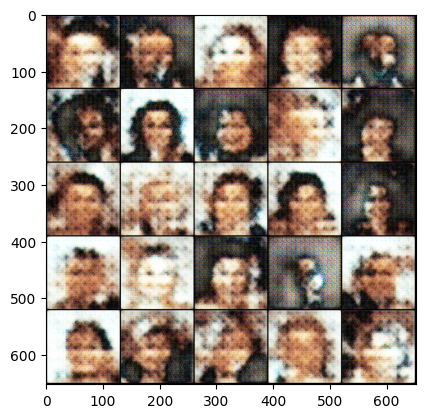

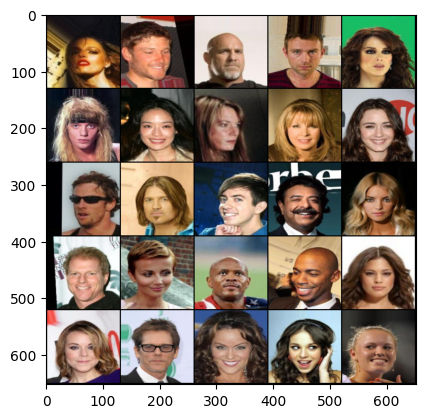

Epoch: 4: Step 350: Generator loss: 25.284416035243442, critic loss: -13.295196974618097


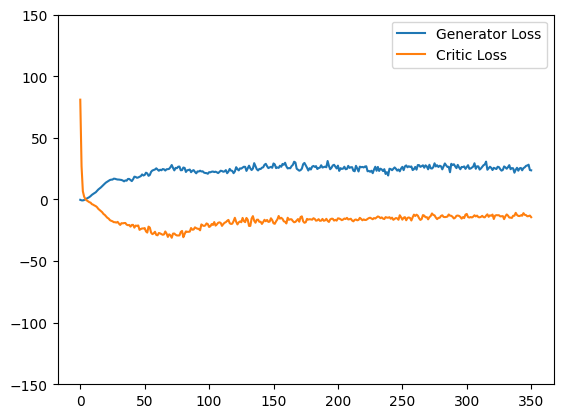

Saving checkpoint:  385 35
Saved checkpoint


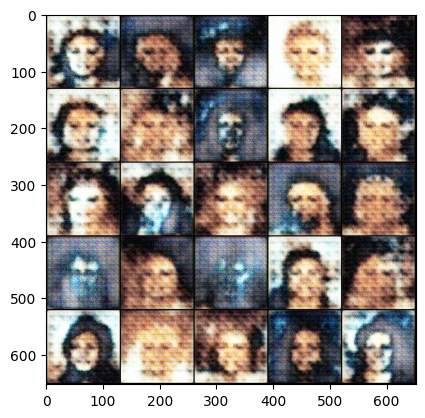

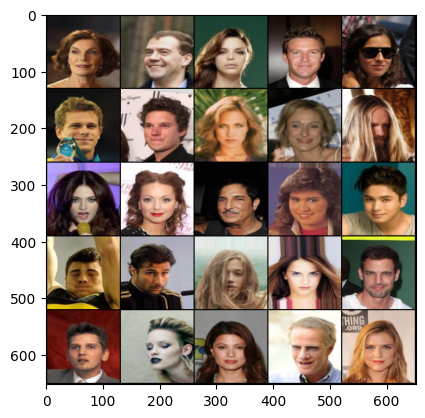

Epoch: 4: Step 385: Generator loss: 26.30566270010812, critic loss: -12.572508302416121


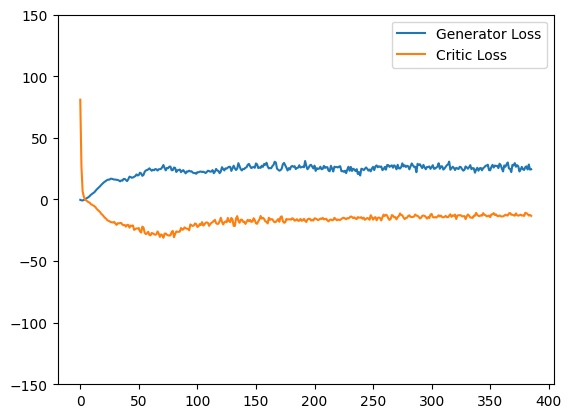

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  420 35
Saved checkpoint


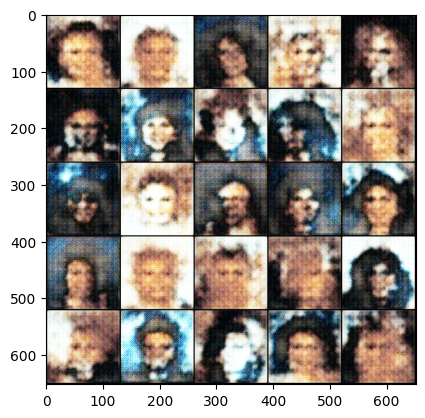

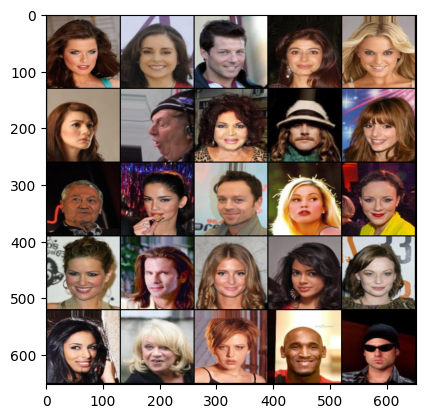

Epoch: 5: Step 420: Generator loss: 26.247693361554827, critic loss: -11.769314986637662


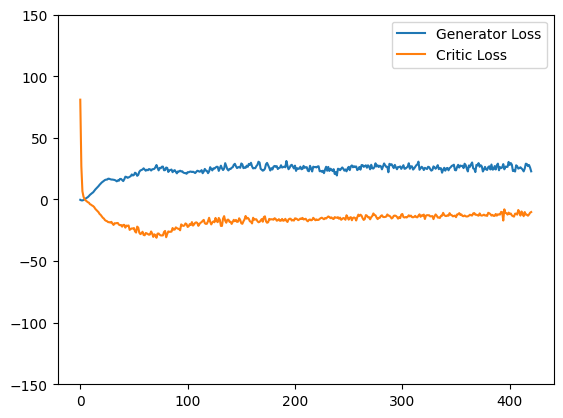

Saving checkpoint:  455 35
Saved checkpoint


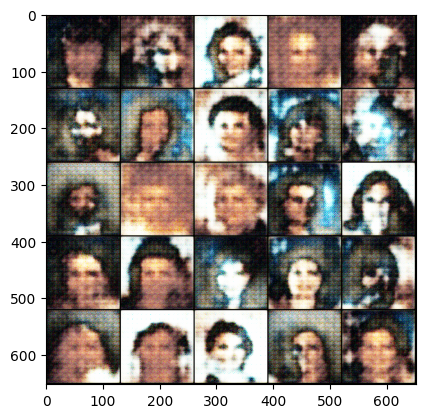

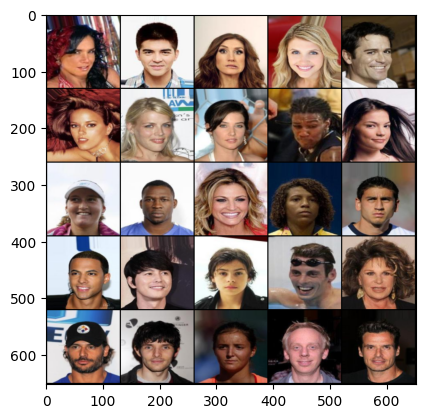

Epoch: 5: Step 455: Generator loss: 25.694263567243304, critic loss: -11.170645375932965


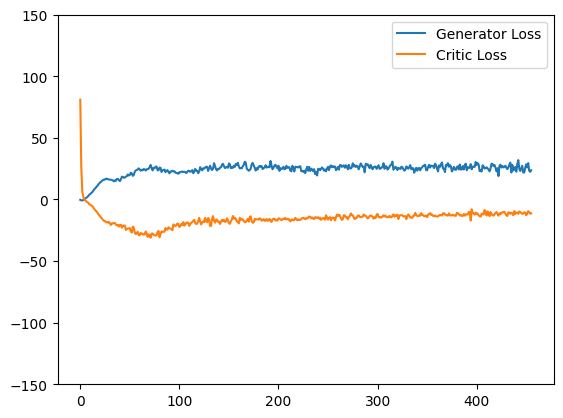

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  490 35
Saved checkpoint


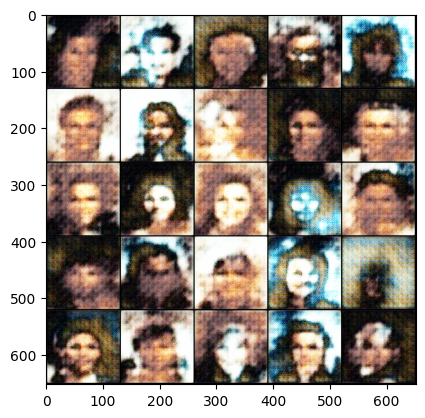

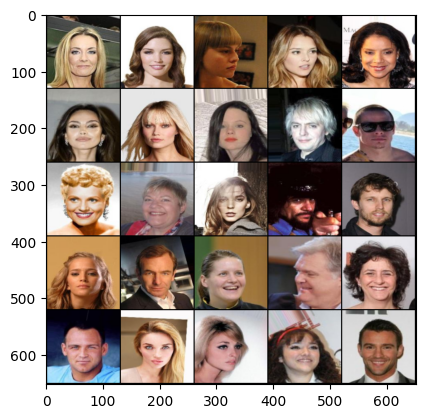

Epoch: 6: Step 490: Generator loss: 25.945040021623885, critic loss: -11.076978762490409


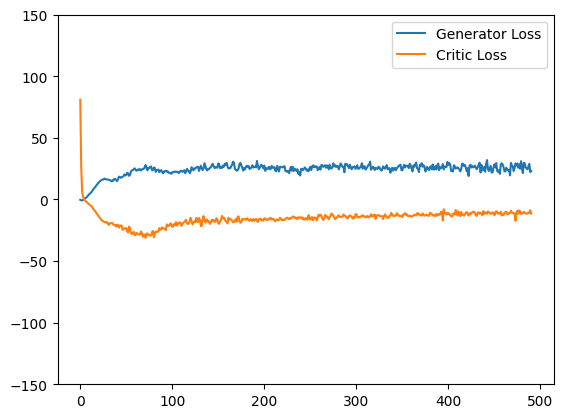

Saving checkpoint:  525 35
Saved checkpoint


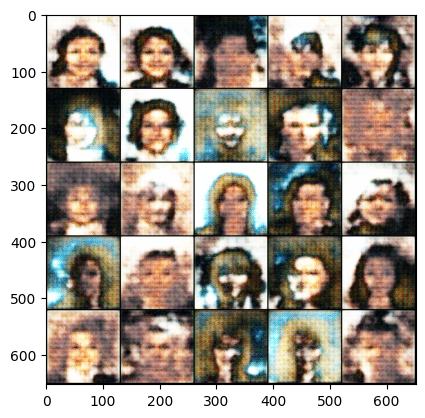

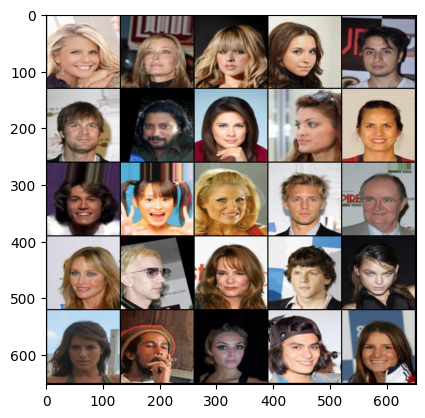

Epoch: 6: Step 525: Generator loss: 26.093567548479353, critic loss: -10.646798310961042


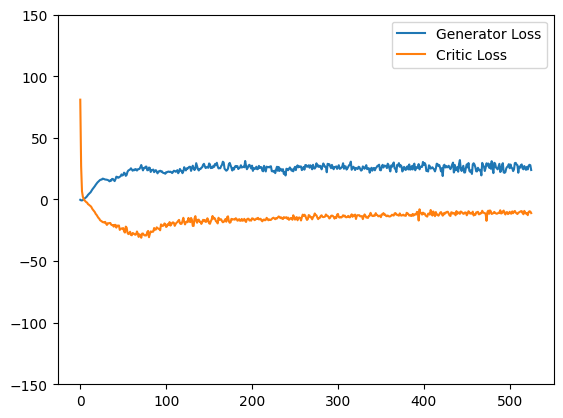

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  560 35
Saved checkpoint


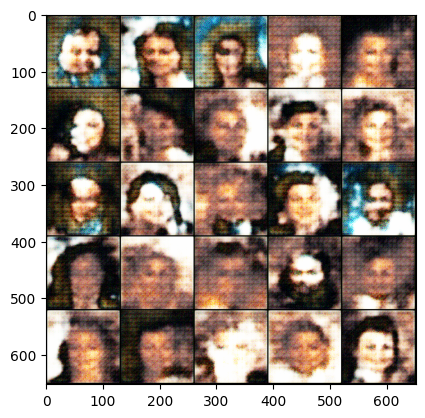

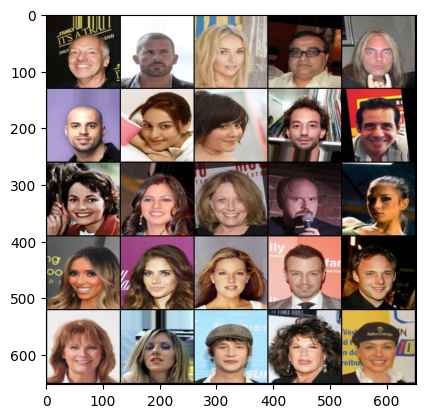

Epoch: 7: Step 560: Generator loss: 28.026692145211356, critic loss: -10.311182196480885


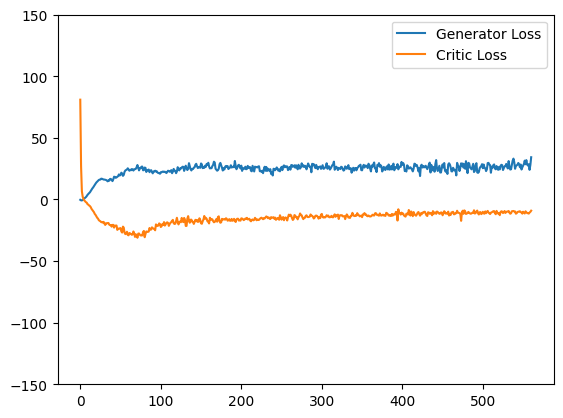

Saving checkpoint:  595 35
Saved checkpoint


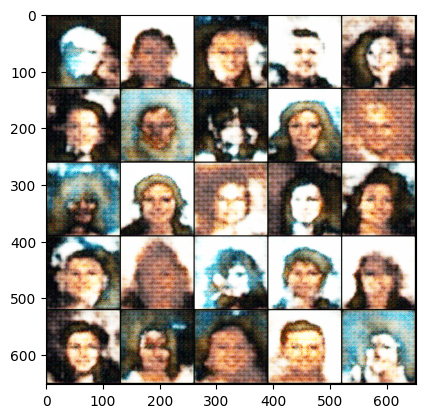

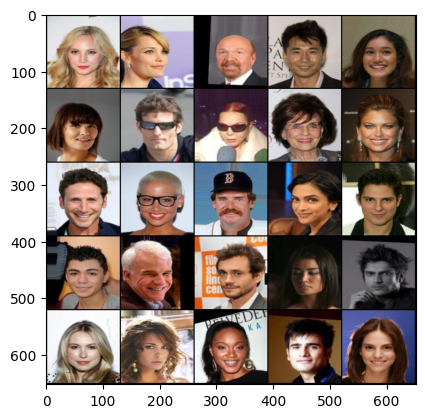

Epoch: 7: Step 595: Generator loss: 27.38035109383719, critic loss: -10.28830039433071


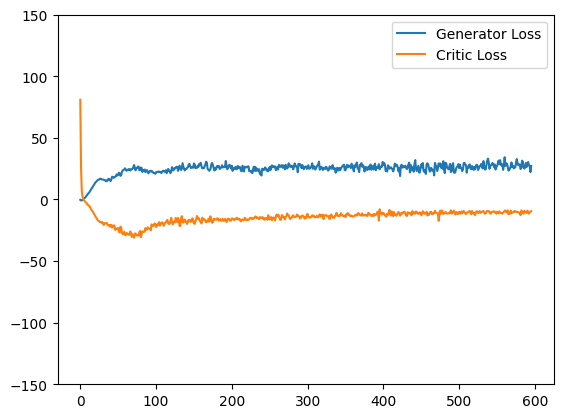

Saving checkpoint:  630 35
Saved checkpoint


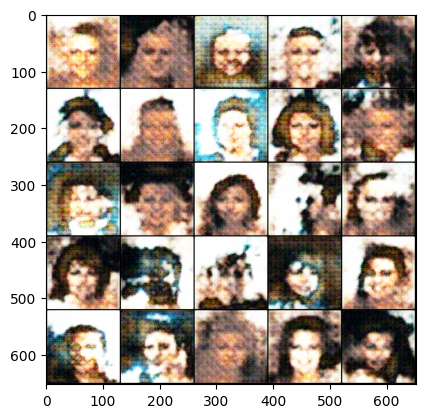

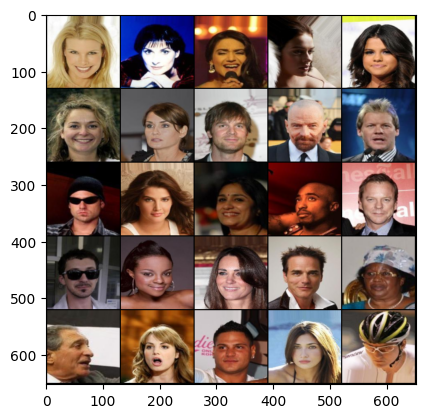

Epoch: 7: Step 630: Generator loss: 27.940431322370255, critic loss: -9.941327904292516


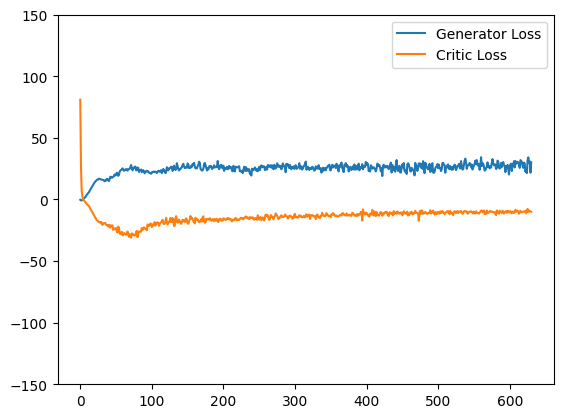

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  665 35
Saved checkpoint


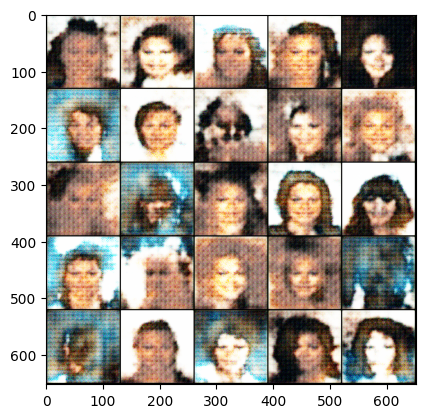

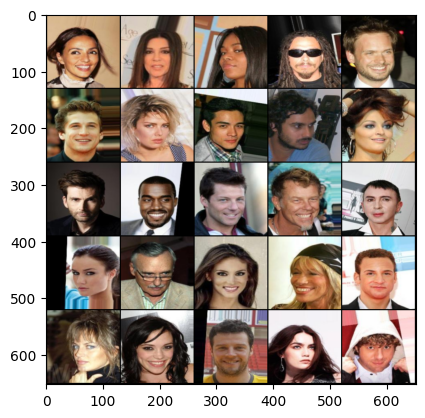

Epoch: 8: Step 665: Generator loss: 29.13563733782087, critic loss: -10.039159349714007


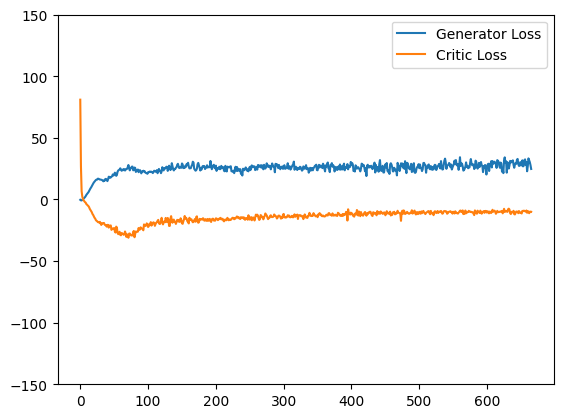

Saving checkpoint:  700 35
Saved checkpoint


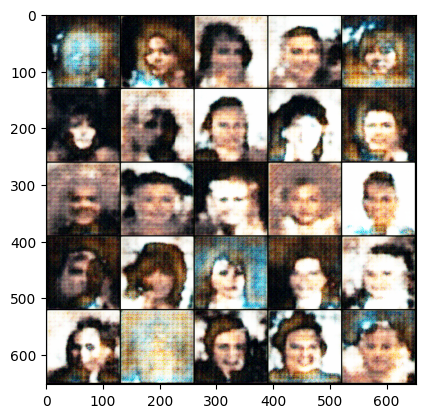

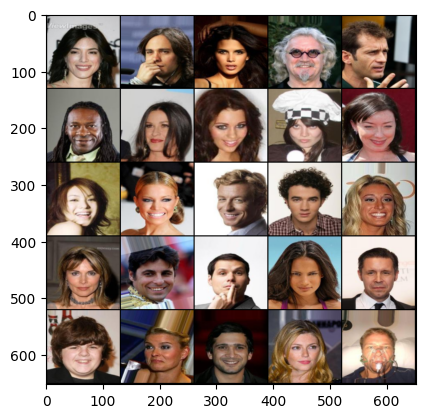

Epoch: 8: Step 700: Generator loss: 29.807993480137416, critic loss: -9.795885611942838


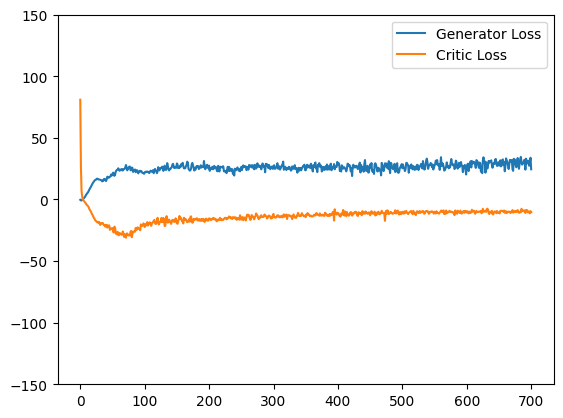

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  735 35
Saved checkpoint


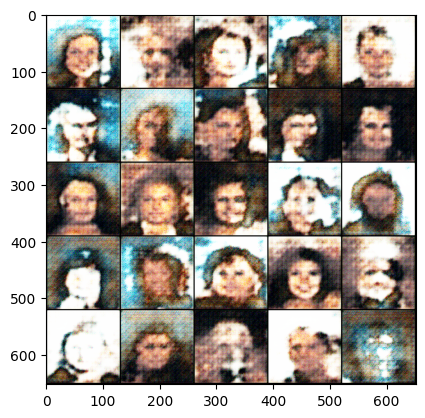

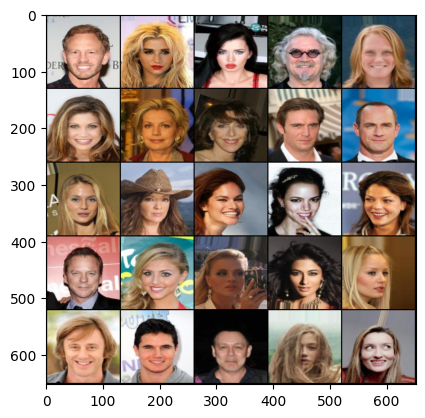

Epoch: 9: Step 735: Generator loss: 31.258578981672013, critic loss: -9.614931079319545


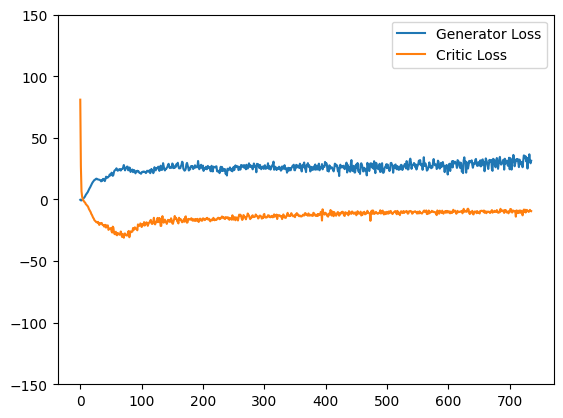

Saving checkpoint:  770 35
Saved checkpoint


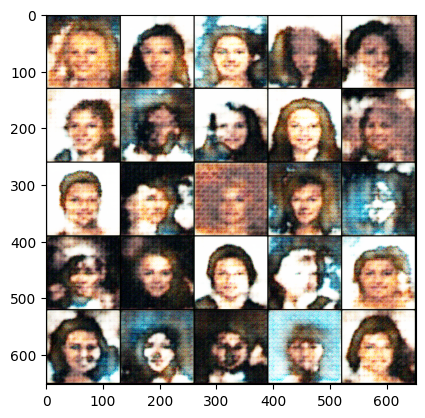

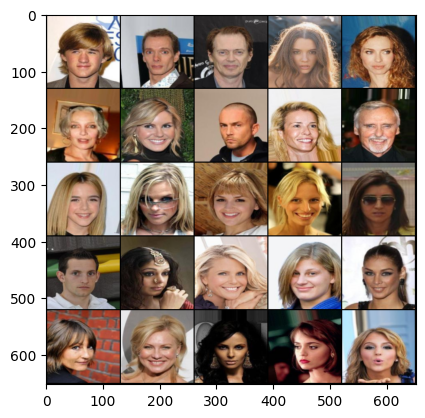

Epoch: 9: Step 770: Generator loss: 30.182924652099608, critic loss: -9.647267755780902


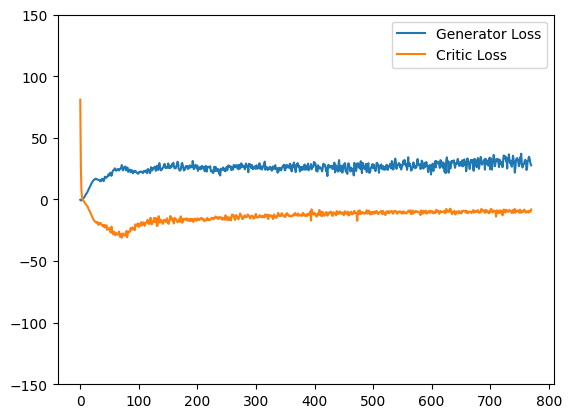

In [ ]:
## Training loop

for epoch in range(n_epochs):
  for real, _ in tqdm(dataloader):
    cur_bs= len(real) #128
    real=real.to(device)

    ### CRITIC
    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()

      noise=gen_noise(cur_bs, z_dim)
      fake = gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)

      alpha=torch.rand(len(real),1,1,1,device=device, requires_grad=True) # 128 x 1 x 1 x 1
      gp = get_gp(real, fake.detach(), crit, alpha)

      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp

      mean_crit_loss+=crit_loss.item() / crit_cycles

      crit_loss.backward(retain_graph=True)
      crit_opt.step()

    crit_losses+=[mean_crit_loss]

    ### GENERATOR
    gen_opt.zero_grad()
    noise = gen_noise(cur_bs, z_dim)
    fake = gen(noise)
    crit_fake_pred = crit(fake)

    gen_loss = -crit_fake_pred.mean()
    gen_loss.backward()
    gen_opt.step()

    gen_losses+=[gen_loss.item()]

    ### Stats

    if (wandbact==1):
      wandb.log({'Epoch': epoch, 'Step': cur_step, 'Critic loss':mean_crit_loss, 'Gen loss': gen_loss})

    if cur_step % save_step == 0 and cur_step > 0:
      print("Saving checkpoint: ", cur_step, save_step)
      save_checkpoint("latest")

    if (cur_step % show_step == 0 and cur_step > 0):
      show(fake, wandbactive=1, name='fake')
      show(real, wandbactive=1, name='real')

      gen_mean=sum(gen_losses[-show_step:]) / show_step
      crit_mean = sum(crit_losses[-show_step:]) / show_step
      print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(gen_losses),
          label="Generator Loss"
      )

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(crit_losses),
          label="Critic Loss"
      )

      plt.ylim(-150,150)
      plt.legend()
      plt.show()

    cur_step+=1


#6. GENERATE NEW FACES

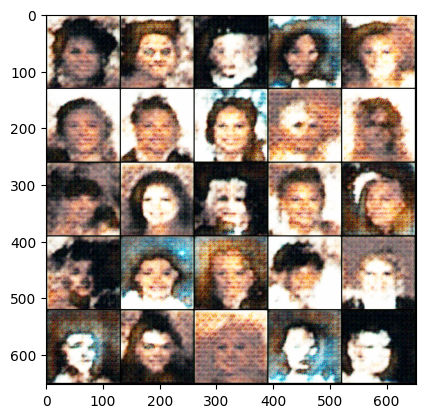

In [ ]:
#### Generate new faces
noise = gen_noise(batch_size, z_dim)
fake = gen(noise)
show(fake)

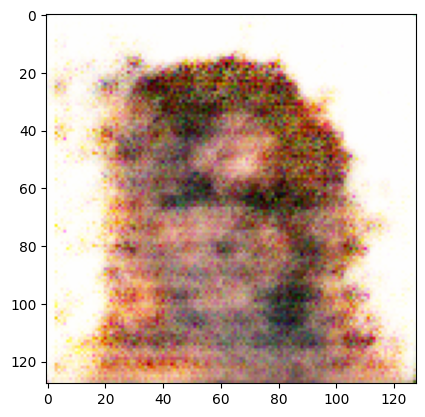

In [ ]:
plt.imshow(fake[9].detach().cpu().permute(1,2,0).squeeze().clip(0,1))

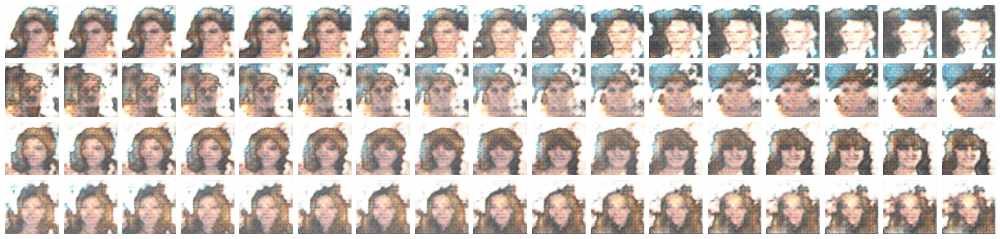

In [ ]:
from mpl_toolkits.axes_grid1 import ImageGrid

# MORPHING, interpolation between points in latent space
gen_set=[]
z_shape=[1,200,1,1]
rows=4
steps=17

for i in range(rows):
  z1,z2 = torch.randn(z_shape), torch.randn(z_shape)
  for alpha in np.linspace(0,1,steps):
    z=alpha*z1 + (1-alpha)*z2
    res=gen(z.cuda())[0]
    gen_set.append(res)

fig = plt.figure(figsize=(25,11))
grid=ImageGrid(fig, 111, nrows_ncols=(rows,steps), axes_pad=0.1)

for ax , img in zip (grid, gen_set):
  ax.axis('off')
  res=img.cpu().detach().permute(1,2,0)
  res=res-res.min()
  res=res/(res.max()-res.min())
  ax.imshow(res.clip(0,1.0))

plt.show()

In [ ]:
files.upload()

Saving G-50.pkl to G-50.pkl
Saving C-50.pkl to C-50.pkl


Loaded checkpoint


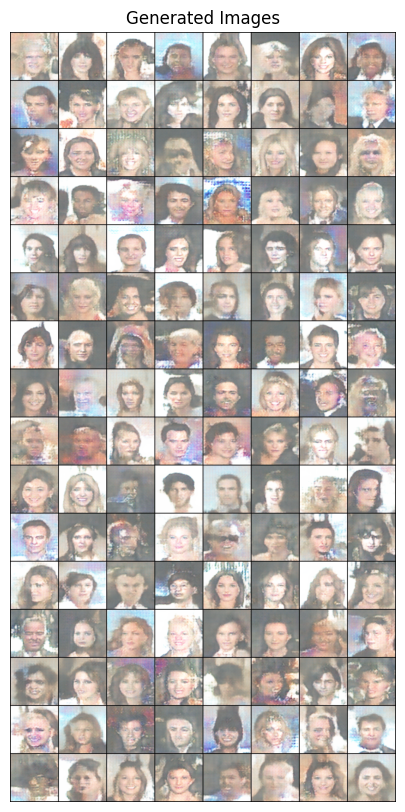

In [ ]:
# Device (CPU/GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Inisialisasi Model
generator = Generator().to(device)
critic = Critic().to(device)

# Inisialisasi Optimizer
gen_opt = torch.optim.Adam(generator.parameters(), lr=1e-4, betas=(0.5, 0.99))
crit_opt = torch.optim.Adam(critic.parameters(), lr=1e-4, betas=(0.5, 0.99))

# Fungsi untuk memuat checkpoint
def load_checkpoint(name):
    checkpoint_g = torch.load(f"/content/G-50.pkl", map_location=device)
    checkpoint_c = torch.load(f"/content/C-50.pkl", map_location=device)

    generator.load_state_dict(checkpoint_g['model_state_dict'])
    gen_opt.load_state_dict(checkpoint_g['optimizer_state_dict'])
    critic.load_state_dict(checkpoint_c['model_state_dict'])
    crit_opt.load_state_dict(checkpoint_c['optimizer_state_dict'])

    print("Loaded checkpoint")

# Muat checkpoint
load_checkpoint(50)

# Set model ke mode evaluasi
generator.eval()

# Generate noise acak
noise = torch.randn(batch_size, z_dim, 1, 1, device=device)

# Hasilkan gambar palsu
with torch.no_grad():
    fake_images = generator(noise)

# Tampilkan gambar
plt.figure(figsize=(10, 10))
plt.axis("off")
plt.title("Generated Images")
plt.imshow(make_grid(fake_images.detach().cpu(), padding=2, normalize=True).permute(1, 2, 0))
plt.show()